### Загрузка библиотек

In [1]:
from scipy.stats import ttest_1samp
import numpy as np
import pandas as pd
import math

from scipy.stats import norm, t, kstest, shapiro
import statsmodels.api as sm
from matplotlib import pyplot as plt


import warnings
warnings.filterwarnings('ignore')
warnings.warn('DelftStack')
warnings.warn('Do not show this message')

In [2]:
[]

[]

In [3]:
np.random.seed(17)

In [4]:
# помимо нармальнного паспределения созpдадим выборку распределения Стьюдента с пятью степенями свободы.
# Напомним что по форме они сильно похожи
x = norm.rvs(size = 250)
y = t.rvs(size = 250, df = 5)

In [5]:
import plotly.express as px

In [6]:
fig = px.histogram(y,
                   x = y,
                   title = 'y', 
                   marginal = 'box',
                   nbins = 100)
# fig.show(renderer="colab")
fig.show()

In [7]:
fig = px.histogram(x,
                   x = x,
                   title = 'x', 
                   marginal = 'box',
                   nbins = 100)
fig.show()

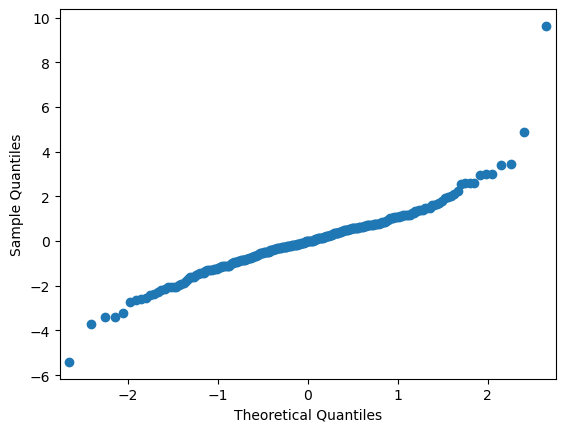

In [8]:
fig = sm.qqplot(y, color = 'green')
plt.title = ("Normal Q-Q Plot")
plt.show()

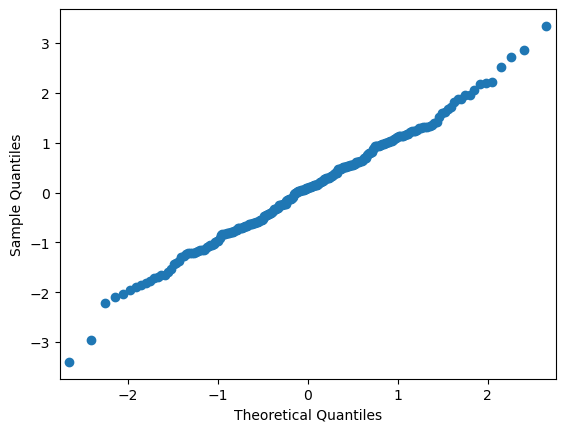

In [9]:
fig = sm.qqplot(x, color = 'green')
plt.title = ("Normal Q-Q Plot")
plt.show()

Тест Колмогорова-Смирнова может использоваться на выборки любого размера

#### Проверка на нормальность теста Колмогорова-Смирнова

Тест Колмогорова-Смирнова применяется для выборки любого размера
- НО: х взята из генеральной совокупности с нормальным распределением
- Н1: х взята из генеральной совокупности с другим распределением
- Тест Колмлгорова-Смирнова также можно использовать для проверки любого другого распределения

Принятие решения

#### При p>alpha можно заклбючить, что анализируемое распределение отличается от нормального

In [10]:
# Проверим принадлежность выборок к нормальному распределению
print(kstest(x,"norm"))
print(kstest(y,"norm"))

KstestResult(statistic=0.057424163162479946, pvalue=0.3678988921991774)
KstestResult(statistic=0.054751982840907654, pvalue=0.4266179885446888)


In [11]:
# Семейство Экспоненциальных (сложная гипотеза)
print(kstest(x,"expon"))

KstestResult(statistic=0.448, pvalue=2.739849972719059e-46)


In [12]:
# Биноминальное, обратим внимание, что оно требует уточненияпораметров(простая гипотеза)
print(kstest(x,"binom", args= (1500, 0.16)))

KstestResult(statistic=1.0, pvalue=0.0)


#### Проверка на нормалольность Тест Шапиро-Уилка

Тест Шапиро-Уилко применяетсмя для выборки состоящей из меннее чем 500 наблюдений
- НО: х взята из генеральной совокупности с нормальным распределением
- Н1: х взята из генеральной совокупности с другим распределением
- Тест Шапиро-Уилко является одним из наиболее мощных критериев для проверки нормальности

Принятие решения
#### При p>alpha можно заключить, что анализируемое распределение не отличается от нормального

In [13]:
W,p_val = shapiro(x)
print("Shapiro-Wilk normaliti test for X")
print("W =", W)
print("P-valye=", p_val)

Shapiro-Wilk normaliti test for X
W = 0.9963920712471008
P-valye= 0.8381169438362122


In [14]:
W,p_val = shapiro(y)
print("Shapiro-Wilk normaliti test for X")
print("W =", W)
print("P-valye=", p_val)

Shapiro-Wilk normaliti test for X
W = 0.9189559817314148
P-valye= 2.0091221741846965e-10


Можно обратить внимание, что тест Шапиро-Уилка отвергает нулевую гипотезу выборки у при том счто тест Колмогорова-Смирнова говорит обратное с P-valye = 0.43

In [15]:
[]

[]

### Анализ мощности теста/расчёт длительности эксперимента

Статистическая
- Размер выбора(Effect size), ошибки 1 рода, ошибки 2 рода
- Дисперсия

Продуктовая
- Сезонность(недельная/месячная
- Метрика(тип метрики и расчёт закрытия метрики

In [16]:
import math
import numpy as np
import statsmodels.stats.power as smp
from tqdm.auto import tqdm
from matplotlib import pyplot as plt
import seaborn as sns

plt.style.use('ggplot')

In [17]:
# Критерий пропорций(нужен для кликов конверсий)
alpha = 0.05
power = 0.9
n = 250
p_x = 0.5
p_y = 0.6

h = 2*math.asin(np.sqrt(p_x)) - 2*math.asin(np.sqrt(p_y))

### Tect procedure

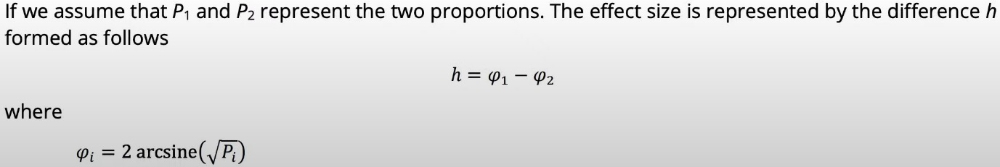

In [18]:
# Какой будет мощность критерия для выборки из n наблюдений, при том что величины эффекта = h c и alpha = 5%
power = smp.zt_ind_solve_power(effect_size = h, nobs1 = n, alpha=alpha, alternative='two-sided')
power

0.6145964066026913

In [19]:
# Какое количество наблюдений необходимо для заданного эффекта, при  alpha = 5% и  power = 80%
smp.zt_ind_solve_power(effect_size = h, alpha=alpha, power=power,  alternative='two-sided')

250.00000000904922

In [20]:
# Какое будет величина эффекта при расчёте теста, при указанных alpha и  power
smp.zt_ind_solve_power( nobs1 = n, alpha=alpha, power=power)

0.2013579262405828

In [21]:
effects = []
sample_sizes = []

for i in tqdm(range(10,10000)):
    effects.append(smp.tt_ind_solve_power(nobs1 = i, alpha=alpha, power=power))
    sample_sizes.append(i)

  0%|          | 0/9990 [00:00<?, ?it/s]

In [22]:
df = pd.DataFrame({'effects':effects, 'sample_sizes':sample_sizes})

In [23]:
df

,effects,sample_sizes
0,1.064082,10
1,1.008782,11
2,0.961358,12
3,0.920092,13
4,0.883751,14
...,...,...
9985,0.031847,9995
9986,0.031845,9996
9987,0.031844,9997
9988,0.031842,9998


In [24]:
import plotly.express as px

In [25]:
fig = px.line(df, 
              x='sample_sizes',
              y='effects', 
              title='effect vs sample size')
# fig.show(renderer = "colab")
fig.show()

In [26]:
power = []
sample_sizes = []

for i in tqdm(range(10,10000)):
    power.append(smp.tt_ind_solve_power(nobs1 = i, alpha=alpha, effect_size=0.1))
    sample_sizes.append(i)

  0%|          | 0/9990 [00:00<?, ?it/s]

In [27]:
df_2 = pd.DataFrame({'power':power, 'sample_sizes':sample_sizes})

In [28]:
df_2

,power,sample_sizes
0,0.055161,10
1,0.055741,11
2,0.056320,12
3,0.056899,13
4,0.057479,14
...,...,...
9985,1.000000,9995
9986,1.000000,9996
9987,1.000000,9997
9988,1.000000,9998


In [29]:
import plotly.express as px

In [30]:
fig = px.line(df_2, 
              x='sample_sizes',
              y='power', 
              title='power vs sample size')
# fig.show(renderer = "colab")
fig.show()

### Множественная проверка гипотез

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

rvs1 = stats.norm.rvs(loc=5, scale=10, size=1000, random_state=0)
rvs2 = stats.norm.rvs(loc=6.5, scale=8, size=1000, random_state=0)

In [32]:
def t_test_function(rvs, alpha, no_test):
    counter = 0
    for i in range(no_test):
        rvs_random = stats.norm.rvs(loc=5, scale=10, size=1000, random_state=i+1)
        
        statistic, pvalue = stats.ttest_ind(rvs, rvs_random, equal_var=False)
        
        if pvalue <= alpha:
            counter = counter + 1
            
    print(counter)

In [33]:
def bonferroni_correction_function(rvs, alpha, no_test):
    alpha_bonferroni = alpha/no_test
    
    counter = 0
    for i in range(no_test):
        rvs_random = stats.norm.rvs(loc=5, scale=10, size=1000, random_state=i+1)
        
        statistic, pvalue = stats.ttest_ind(rvs, rvs_random, equal_var=False)
        
        if pvalue <= alpha_bonferroni:
            counter = counter + 1
            
    print(counter)

In [34]:
t_test_function(rvs1, alpha=0.05, no_test=100)
t_test_function(rvs2, alpha=0.05, no_test=100)

bonferroni_correction_function(rvs1, alpha=0.05, no_test=100)

bonferroni_correction_function(rvs2, alpha=0.05, no_test=100)

11
85
0
18


### Бутстрап

In [35]:
!pip install bootstrapped

Defaulting to user installation because normal site-packages is not writeable


In [36]:
import numpy as np
import pandas as pd
from scipy.stats import norm
import matplotlib.pyplot as plt

from tqdm.auto import tqdm


import bootstrapped.bootstrap as bs
import bootstrapped.compare_functions as bs_compare
import bootstrapped.stats_functions as bs_stats

plt.style.use('ggplot')

In [37]:
n=11000

sample_A = np.random.exponential(scale=1/0.002, size=n)
sample_B = np.random.exponential(scale=1/0.00201, size=n)

df = pd.DataFrame({ "sample_A": sample_A,  "sample_B": sample_B})

In [38]:
s1 = df.sample_A.values

s2 = df.sample_B.values

b = bs.bootstrap_ab(s1,s2, stat_func=bs_stats.mean,
compare_func=bs_compare.difference, alpha=0.05, num_iterations=10000)

print(b.lower_bound, b.upper_bound )

-13.575697117009774 12.542098662542871


In [39]:
v = bs.bootstrap_ab(s1,s2, stat_func=bs_stats.std,
compare_func=bs_compare.difference, alpha=0.05, num_iterations=10000)

print(v.lower_bound, v.upper_bound )

-20.442240280959 16.275232624979612


### Бакетирование

Трансформация распределенияслучайной величины в нормальное с помощью техники бакетирования.

Бакетирование подъходит тогда, когда необходимо:
- сохранить информацию  о дисперсии и среднем в выборке до трансформации
- привести к нормальному распределению

Сгенерируем данные. В качестве примера используем эксп. распределение

Возьмём кратное количество групп. Допустим12000(можно взять и 300,и 600

In [91]:
import numpy as np
import scipy.stats as st
from scipy.stats import norm
import pandas as pd

plt.style.use('ggplot')

In [92]:
b = 2000
n = 200000

val_A = np.random.exponential(scale=1/0.02, size=n)
val_B = np.random.exponential(scale=1/0.021, size=n)

sample_exp = pd.DataFrame({
    "metric":  np.concatenate([val_A, val_B]),
    "group": ["A" for i in range(n)] + ["B" for i in range(n)],
    "bucket":  [i for i in range(b)] *int(n*2/b)
    })


In [93]:
# Агрегация по баккетам и считаем среднее:

backeted_df = sample_exp.groupby(by=["bucket", "group"])["metric"].agg(
    mu=np.mean,
    sd_mu=np.std
).reset_index()

In [94]:
backeted_df.head()

,bucket,group,mu,sd_mu
0,0,A,53.346035,46.352276
1,0,B,52.962489,56.819336
2,1,A,47.810608,46.510596
3,1,B,45.695982,45.906573
4,2,A,56.079222,56.023725


In [95]:
# Сравним  выбороочное среднее и среднее по баккетам

round(np.mean(sample_exp["metric"]),3) == round(np.mean(backeted_df["mu"]),3)

True

In [96]:
np.var(sample_exp["metric"]) / len(sample_exp["metric"])

0.0059959139503042

In [97]:
np.var(backeted_df["mu"]) / len(backeted_df["mu"])

0.0065408611576023

In [98]:
sample_exp

,metric,group,bucket
0,102.580246,A,0
1,2.082194,A,1
2,19.191053,A,2
3,38.922766,A,3
4,25.135427,A,4
...,...,...,...
399995,0.550445,B,1995
399996,38.437717,B,1996
399997,4.879128,B,1997
399998,90.637579,B,1998


In [122]:
import plotly.express as px
fig = px.histogram(sample_exp,
                   x = sample_exp.metric,
                   title = 'x', 
                   marginal = 'box')
#                    nbins = 500)
# fig.show(renderer="colab")
fig.show()

In [123]:
import plotly.express as px
fig = px.histogram(backeted_df,
                   x = backeted_df.mu,
                   title = 'x', 
                   marginal = 'box')
#                   nbins = 100)
# fig.show(renderer="colab")
fig.show()

In [86]:
sl = sample_exp[sample_exp.group=='A'].metric.values

s2 = sample_exp[sample_exp.group=='B'].metric.values

b = bs.bootstrap_ab(s1,s2, stat_func=bs_stats.mean,
compare_func=bs_compare.difference, alpha=0.05, num_iterations=500)

print(b.lower_bound, b.upper_bound )

434.21605479394754 452.855666969061


In [87]:
sl = backeted_df[backeted_df.group=='A'].mu.values

s2 = backeted_df[backeted_df.group=='B'].mu.values

b = bs.bootstrap_ab(s1,s2, stat_func=bs_stats.mean,
compare_func=bs_compare.difference, alpha=0.05, num_iterations=500)

print(b.lower_bound, b.upper_bound )

434.507361836177 452.0234631382707


In [124]:
# data = pd.read_csv('a_b test ecom - ab_test 2.csv')

In [125]:
data = pd.read_csv('gb_sem_9_cw.csv')

In [126]:
data.head(10)

,id,time,con_treat,page,converted
0,851104,11:48.6,control,old_page,0
1,804228,01:45.2,control,old_page,0
2,661590,55:06.2,treatment,new_page,0
3,853541,28:03.1,treatment,new_page,0
4,864975,52:26.2,control,old_page,1
5,936923,20:49.1,control,old_page,0
6,679687,26:46.9,treatment,new_page,1
7,719014,48:29.5,control,old_page,0
8,817355,58:09.0,treatment,new_page,1
9,839785,11:06.6,treatment,new_page,1


In [127]:
z= data.time

In [128]:
c1 = data.converted.sum()
c1

35237

In [129]:
c2 = data["converted"].value_counts()
c2

0    259241
1     35237
Name: converted, dtype: int64

In [130]:
c3 = data["con_treat"].value_counts()
c3

treatment    147276
control      147202
Name: con_treat, dtype: int64

In [131]:
data_control = data[data["con_treat"] == 'control']

In [132]:
data_control.head(5)

,id,time,con_treat,page,converted
0,851104,11:48.6,control,old_page,0
1,804228,01:45.2,control,old_page,0
4,864975,52:26.2,control,old_page,1
5,936923,20:49.1,control,old_page,0
7,719014,48:29.5,control,old_page,0


In [133]:
data_treatment = data[data["con_treat"] == 'treatment']
data_treatment.head(5)

,id,time,con_treat,page,converted
2,661590,55:06.2,treatment,new_page,0
3,853541,28:03.1,treatment,new_page,0
6,679687,26:46.9,treatment,new_page,1
8,817355,58:09.0,treatment,new_page,1
9,839785,11:06.6,treatment,new_page,1


In [134]:
a=np.array(data.converted)
print(np.sum(a==1))


35237
